## IMPORTACIÓ INFORMACIÓ DE SABIO-RK

Per obtenir les dades necessàries per a generar el model utilitzarem la web SABIO-RK d'on ens descarregarem tota la informació per començar a treballar. Per fer-ho cal que ens instal·lem el paquet de python _requests_. 

El paquet _requests_ és una biblioteca utilitzada per realitzar sol·licituts HTTP i interactuar amb recursos web. Proporciona una API simple i intuitiva per enviar sol·licituts HTTP, manipular respostes i gestionar aspectes de comunicació web. 

La instal·lació d'aquest paquet ens permetrà reportar informació específica de la base  dades. Concretament volem generar un document csv on hi guardem els camps SabioReaction ID, Name, Role i Smiles de totes les molècules que formen reaccions químiques. Seguidament importem els ECNumbers de cada reacció, ja que es troben en una altra URL i no ho podem importar tot junt. 

A continuació es crearà un script per tenir un document final amb les següents columnes: SabioReaction ID, Name, Role, Smiles i ECNumber.

In [2]:
#install
import requests
import pandas as pd 

from rdkit import Chem
from urllib.request import urlopen
from urllib.parse import quote

def CIRconvert(ids):
    try:
        url = 'http://cactus.nci.nih.gov/chemical/structure/' + quote(ids) + '/smiles'
        ans = urlopen(url).read().decode('utf8')
        return ans
    except:
        return 'Did not work'


import os.path 

datafile = "data/smiles.csv"

if os.path.exists(datafile): 
    print(datafile, " exists") 
else: 
    print("Generating ",datafile)

    QUERY_URL = 'http://sabiork.h-its.org/sabioRestWebServices/searchReactionParticipants'
 
    query = {"SabioReactionID":"*", "fields[]":["Name","Role", "Smiles" ]}

    request = requests.post(QUERY_URL, params = query) 
    request.raise_for_status() 

    print(request.text)

    # results

    fh=open(datafile, "w")

    fh.write(request.text)



data/smiles.csv  exists


A partir de la informació descarregada a la web SABIO-RK hem generat un document csv (smiles.csv) amb la informació de tota la basa de dades, concretament de 16.513 molècules.

In [3]:
smilesfile = "data/smiles.csv"

Ens descarraguem els ECNumbers presents a SABIO-RK:

In [4]:
datafile = "data/ECnumber.csv"

if os.path.exists(datafile):
    print(datafile, "exists")
else:
    print("Generting", datafile)

    QUERY_URL = 'http://sabiork.h-its.org/sabioRestWebServices/searchReactionDetails' 

    query = {"SabioReactionID":"*", "fields[]":["SabioReactionID", "ECNumber"]} 

    # make GET request 
    request = requests.get(QUERY_URL, params = query) 
    request.raise_for_status() 

    #results 
    print(request.text) 

    fh=open("data/ECnumber.csv", "w")

    fh.write(request.text)

    df = pd.read_csv("data/ECnumber.csv", sep='\t')
    df1 = df.sort_values('SabioReactionID')
    print(df1)

data/ECnumber.csv exists


A partir de la informació present a la web ens hem descarregats tots els ECNumbers de les molècules de la base de dades SABIO-RK. Hem generat un document csv (ECnumber.csv) amb 12.165 molècules i els seus ECNumbers. 

Tenint en compte que en el document anterior teniem 16.513 molècules, d'aquestes només podrem utilitzar 12.165 ja que de la resta no tenim informació de l'ECNumber.

Ajuntem els dos documents csv per obtenir el document csv final amb les columnes, SabioReaction ID, Name, Role, Smiles i ECNumber, utilitzant la instrucció "merged".

In [6]:
input1=smilesfile
input2='data/ECnumber.csv'

df1 = pd.read_csv(input1, sep='\t')
df2 = pd.read_csv(input2, sep="\t")

# Merge the two dataframes on the common column "numbers"
merged_df = pd.merge(df1, df2, on="SabioReactionID")

# Write the merged dataframe to a new CSV file
merged_df.to_csv("data/SmilesEC.csv", index=False)

## Control de qualitat de les dades importades de SABIO-RK

L'objectiu d'aquest apartat consisteix en eliminar els reactius i productes d'aquelles reaccions que no disposem de tots els smiles de la reacció. 

In [7]:
input= "data/smiles.csv"
df1 = pd.read_csv(input, sep='\t')



In [8]:
input= "data/smiles.csv"
df1 = pd.read_csv(input, sep='\t')
df1.columns

Index(['SabioReactionID', 'Name', 'Role', 'Smiles'], dtype='object')

In [9]:
input= "data/smiles.csv" #importem el csv smiles obtingut de SABIO-RK
output='data/smilesCQ.csv'
df1 = pd.read_csv(input, sep='\t') #llegim el csv i el guardem a la variable df1 com un dataframe.
#Volem eliminar tota la informació de les reaccions que tinguin algun valor nul en els seus subtrats i productes a la columna smiles.

#Primer afegim 0 on tronem valors NaN a la columna Smiles del dataframe.
df1['Smiles'] = df1['Smiles'].fillna(0)

# generem una llista buida on guardarem el SabioReactionID dels substrats i productes que ens falta informació. Ja que seguidament voldrem eliminar tots els productes i substrats de la reacció.
list1 = [] 

# iterem el df1, si Smiles és igual a 0 afegim el SabioReactionID a la list1  

for i in range(len(df1)): 
    smi=df1.loc[i,'Smiles']
    #print(smi)
    if smi == 0:
        list1.append(df1.loc[i,'SabioReactionID']) 
    elif Chem.MolFromSmiles(smi) == None:
        list1.append(df1.loc[i,'SabioReactionID']) 
#Eliminem del df1 tots els substrats i productes que tinguin el SabioReactionID igual que el que s'ha guardat a la llista
df = df1.drop(df1[df1['SabioReactionID'].isin(list1)].index) 


df.to_csv(output, index=False) #obtenim un nou fitxer smilescq.csv on hem eliminat tots els elements de les reaccions que ens faltava informació

[18:20:54] WARNING: not removing hydrogen atom without neighbors
[18:20:54] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[18:20:54] WARNING: not removing hydrogen atom without neighbors
[18:20:54] WARNING: not removing hydrogen atom without neighbors
[18:20:54] WARNING: not removing hydrogen atom without neighbors
[18:20:54] WARNING: not removing hydrogen atom without neighbors
[18:20:54] WARNING: not removing hydrogen atom without neighbors
[18:20:54] WARNING: not removing hydrogen atom without neighbors
[18:20:54] WARNING: not removing hydrogen atom without neighbors
[18:20:54] WARNING: not removing hydrogen atom without neighbors
[18:20:54] WARNING: not removing hydrogen atom without neighbors
[18:20:54] Can't kekulize mol.  Unkekulized atoms: 1 2 3 4 5 6 7 8 9
[18:20:55] Can't kekulize mol.  Unkekulized atoms: 5 6 7 8 9
[18:20:55] WARNING: not removing hydrogen atom without neighbors
[18:20:55] Can't kekulize mol.  Unkekulized atoms: 6 7 8 9 10
[18:20:55] WARNING: not removin

In [11]:
input= "data/smilesCQ.csv"
df1 = pd.read_csv(input, sep='\t')
df1.columns

df1.columns

Index(['SabioReactionID,Name,Role,Smiles'], dtype='object')

Mitjançant funcions de RDKit modifiquem Smiles per tal de fixar els dobles enllaços.

# ReactionSmiles.csv

A partir del document smiles.csv es genera un fitxer amb les reaccions.

In [12]:
input= "data/smilesCQ.csv"
output='data/ReactionSmiles.csv'

df1 = pd.read_csv(input, sep='\t')
df2 = pd.DataFrame(columns=["SabioReactionID", "Reaction"]) #, index=range(numrows))
numrows=16513

#Creem dues llistes buides amb tants strings com files. Generem una llista R per guardar els reactius i una llista P per guardar els productes.
R=[""]*(numrows+1)
P=[""]*(numrows+1)
isFirstR=[True]*(numrows+1)
isFirstP=[True]*(numrows+1)

def check_smiles(smiles):
    print(smiles)
    if not smiles:
        print('Wrong SMILES for:',smiles)
        return 0
    return 1

#Fem una iteració per cada fila del dataframe amb el command: for index, row in df.iterrows():
for index, row in df.iterrows():
    rid=row['SabioReactionID']
    name=row["Name"]
    smiles=row["Smiles"]
    if check_smiles(smiles) == 0:
        break
   
    role=row["Role"]
    if role == "Substrate": 
        if isFirstR[rid]:
            R[rid]=R[rid] + smiles 
            isFirstR[rid]= False
        else:
            R[rid]=R[rid] + "." + smiles       
        
    elif role == "Product":
        if isFirstP[rid]:
            P[rid]=P[rid]+smiles
            isFirstP[rid]=False
        else:
            P[rid]=P[rid] +"."+ smiles
    else:
        print("error, name")
    print(R[rid],P[rid])
    df2.at[rid, "SabioReactionID"]=rid

for i in range(numrows):
    print(R[i]+">"+P[i])
    df2.at[i, "Reaction"]=R[i]+">>"+P[i]

  

df2.drop(df2.tail(11754).index,inplace=True)
print(df2)

#obtenim ReactionSmiles.csv.
df2.to_csv(output, index=False)

C([C@@H]1[C@H]([C@@H]([C@H]([C@H](O1)O)O)O)O)OP(=O)(O)O
C([C@@H]1[C@H]([C@@H]([C@H]([C@H](O1)O)O)O)O)OP(=O)(O)O 
C([C@@H]1[C@H]([C@@H]([C@](O1)(CO)O)O)O)OP(=O)(O)O
C([C@@H]1[C@H]([C@@H]([C@H]([C@H](O1)O)O)O)O)OP(=O)(O)O C([C@@H]1[C@H]([C@@H]([C@](O1)(CO)O)O)O)OP(=O)(O)O
Nc3ncnc1c3(ncn1C2OC(COP(O)(=O)OP(O)(=O)OP(O)(O)=O)C(O)C2(O))
Nc3ncnc1c3(ncn1C2OC(COP(O)(=O)OP(O)(=O)OP(O)(O)=O)C(O)C2(O)) 
OC1C(COP(O)(O)=O)OC(O)(COP(O)(O)=O)C1(O)
Nc3ncnc1c3(ncn1C2OC(COP(O)(=O)OP(O)(=O)OP(O)(O)=O)C(O)C2(O)) OC1C(COP(O)(O)=O)OC(O)(COP(O)(O)=O)C1(O)
Nc3ncnc1c3(ncn1C2OC(COP(O)(=O)OP(O)(O)=O)C(O)C2(O))
Nc3ncnc1c3(ncn1C2OC(COP(O)(=O)OP(O)(=O)OP(O)(O)=O)C(O)C2(O)) OC1C(COP(O)(O)=O)OC(O)(COP(O)(O)=O)C1(O).Nc3ncnc1c3(ncn1C2OC(COP(O)(=O)OP(O)(O)=O)C(O)C2(O))
C([C@@H]1[C@H]([C@@H]([C@](O1)(CO)O)O)O)OP(=O)(O)O
Nc3ncnc1c3(ncn1C2OC(COP(O)(=O)OP(O)(=O)OP(O)(O)=O)C(O)C2(O)).C([C@@H]1[C@H]([C@@H]([C@](O1)(CO)O)O)O)OP(=O)(O)O OC1C(COP(O)(O)=O)OC(O)(COP(O)(O)=O)C1(O).Nc3ncnc1c3(ncn1C2OC(COP(O)(=O)OP(O)(O)=O)C(O)C2(O))
[

S'afageix els ECNumber de cada reacció i s'eliminen aquelles reaccions que no tenen ECNumber.

In [13]:
input1="data/ReactionSmiles.csv"
input2='data/ECnumber.csv'

df1 = pd.read_csv(input1, sep=',')
df2 = pd.read_csv(input2, sep="\t")

# A partir de la funció Merge ajuntem els dos dataframes tenint en compte la columna del SabioReactionID. D'aquesta manera aconseguim un dataframe amb la columna ReactionSmiles i la columna ECNumber.
merged_df = pd.merge(df1, df2, on="SabioReactionID")

#Eliminar aquelles reaccions que no disposin d'ECNumber.
merged_df = merged_df.drop(merged_df[merged_df['ECNumber'] == "-"].index)

# Escrivim el dataframe final a un nou CSV file. 
merged_df.to_csv("data/ReactionSmilesEC1.csv", index=False)

Per poder traball amb RDKit i obtenir les _features_ de cada substància necessitem un csv amb els SMILES de cada substrat i producte per separat. L'objectiu del seggüent script és obtenir un llistat de tots els substrats i productes de totes les reaccions químiques del nostre dataset sense tenir molècules per duplicat. 

In [14]:
# En el següent script treballarem a partir del csv obtingut de SABIO-RK:
input= "data/smilesCQ.csv"
output='data/moleculesSmiles.csv'

df1 = pd.read_csv(input, sep=',')

#Eliminem totes les molècules que no tinguin SMILES.
df1['Smiles'] = df1['Smiles'].fillna(0)
# creem uns llista buida.  
list1 = [] 
#smiles=row["Smiles"]   
for i in range(len(df1)): 

    # comprovem si Smiles és igual a 0, llavors afegim el valors SabioReactionID a la llista list1 
    if df1.loc[i,'Smiles'] == 0: 
        list1.append(df1.loc[i,'SabioReactionID']) 

df = df1.drop(df1[df1['SabioReactionID'].isin(list1)].index) 

#Una vegada hem eliminat les molècules que no tenen SMILES eliminem aquelles molècules duplicades al dataframe.
dfmolecules = df.drop_duplicates(subset="Smiles")

#Guardem el dataframe en un csv file moleculesSmiles.csv
print(dfmolecules)
dfmolecules.to_csv(output, index=False)

## ELIMINAR COLUMNES NAME ROLE : SIMILES / GUARDAR ELS SABIOS ID DE TOTES LES REACCIONS QUE APAREIX LA MOLÈCULA

       SabioReactionID                                   Name       Role  \
0                    1            alpha-D-Glucose 6-phosphate  Substrate   
1                    1            beta-D-Fructose 6-phosphate    Product   
2                    2                                    ATP  Substrate   
3                    2       beta-D-Fructose 1,6-bisphosphate    Product   
4                    2                                    ADP    Product   
...                ...                                    ...        ...   
20683            16502                        10-Formylfolate  Substrate   
20694            16507  15-Keto-prostaglandin E2 methyl ester    Product   
20695            16507          Prostaglandin E2 methyl ester  Substrate   
20699            16513           2-Heptyl-3-hydroxy-quinolone  Substrate   
20700            16513             n-Octanoylanthranilic acid    Product   

                                                  Smiles  
0      C([C@@H]1[C@H]([C@@H]

# RDKit
 És una llibreria de codi obert de química computacional de python. Està dissenyat per a la manipulació de molècules i estructures químiques. RDKit té moltes funcions algunes d'elles són la conversió entre diferents formats de fitxers de molècules, la generació d'estructures moleculars, el càlcul de propietats físico-químiques de les molècules, com ara la solubilitat, el pes molecular, el nombre d'àtoms rotatius, la càrrega, etc. També permet generar visualitzacions 2D i 3D de molècules. Nosaltres l'utilizarem per a obtenir les _features_ , propietats fisico-químiques, que ens serviran de _finguerprints_ per a la generació del model ML. 

 Descriptors RDKit:

- Pes molecular: El pes molecular d'una molècula pot estar relacionat amb la seva activitat enzimàtica, ja que les molècules més grans o més complexes poden tenir més probabilitats d'interaccionar amb enzims específics. 

- Lipofílicitat: Capacitat d'un compost a dissoldre's en lípids o dissolvents no polars.

- Àrea de superfície polar topològica (TPSA) Chem.Descriptors.TPSA(): és una mesura de l'àrea superficial d'una molècula que és polar o capaç de participar en l'enllaç d'hidrogen. La TPSA pot estar relacionada amb l'activitat enzimàtica, ja que molts enzims tenen llocs actius polars o carregats. 

- Nombre d'heteroàtoms. NumHeteroatoms()

- Nombre d'anells. RingCount()

- Nombre d'anells aromàtis. NumAromaticRings()

- Nombre d'àtoms pesants: Chem.Descriptors.HeavyAtomCount(mol)

- Nombre d'anells alifàtics: Chem.Descriptors.NumAliphaticRings(mol)

- Fraction of carbons that are sp3 hybridized: Chem.Descriptors.FractionCSP3(mol)

- Number of chiral centers: Chem.Descriptors.NumChiralCenters(mol)

- Balaban J index: Chem.Descriptors.BalabanJ(mol) : L'índex J de Balaban mesura el grau d'insaturació d'una molècula. Està relacionat amb la reactivitat química i l'estabilitat d'una molècula, així com amb la seva aromaticitat. Les molècules amb índex més alts tendeixen a tenir graus més alts d'insaturació i, per tant, són més reactives mentre que les molècules amb índex més baixos solen ser més estables.

- Number of rotatable bonds: Chem.Descriptors.NumRotatableBonds(mol)

In [15]:
import pandas as pd
from rdkit import Chem
from rdkit.Chem import Crippen, Descriptors
import matplotlib.pyplot as plt

df1 = pd.read_csv('data/moleculesSmiles.csv', sep=',')
output = 'data/fingerprint.csv'

mols = df1['Smiles']
def features(mol, data):
    # Crear un objeto RDKit::ROMol a partir de la cadena SMILES
    mol = Chem.MolFromSmiles(mol)

    # Verificar si se creó correctamente el objeto mol
    if mol is not None:
        # Obtener las propiedades utilizando funciones de RDKit
        formula = Chem.rdMolDescriptors.CalcMolFormula(mol)
        mw = Chem.rdMolDescriptors.CalcExactMolWt(mol)
        logp = Chem.Descriptors.MolLogP(mol)
        tpsa = Chem.rdMolDescriptors.CalcTPSA(mol)
        num_rc = Chem.Descriptors.RingCount(mol)
        num_HAC = Chem.Descriptors.HeavyAtomCount(mol)
        num_AR = Chem.Descriptors.NumAliphaticRings(mol)
        CSP3 = Chem.Descriptors.FractionCSP3(mol)
        BJI = Chem.Descriptors.BalabanJ(mol)
        num_RB = Chem.Descriptors.NumRotatableBonds(mol)
        num_hbd = Chem.rdMolDescriptors.CalcNumHBD(mol)
        num_hba = Chem.rdMolDescriptors.CalcNumHBA(mol)

        # Agregar los resultados a una lista de datos
        data.append([ mw, logp, tpsa, num_rc, num_AR, num_HAC, num_AR, CSP3, BJI, num_RB, num_hbd, num_hba])
    else:
        print("No se pudo crear el objeto mol correctamente.")

    return

data = []

for mol in mols:
    features(mol, data)

llistadescriptors = ['MW', 'logP', "TPSA", "Rings Count", "Aromatic Rings", "Heavy atoms count", "Aliphatic Rings",
                     "CSP3", "BalabanJ", "Rotatable Bonds", "H-bond donor", "H-bond acceptor"]

df = pd.DataFrame(data, columns=llistadescriptors)
df["Smiles"] = df1["Smiles"]

print(df)

df.to_csv(output, index=False)

[18:21:37] WARNING: not removing hydrogen atom without neighbors
[18:21:41] WARNING: not removing hydrogen atom without neighbors
[18:21:41] WARNING: not removing hydrogen atom without neighbors


              MW     logP    TPSA  Rings Count  Aromatic Rings  \
0     260.029719 -3.10440  156.91            1               1   
1     260.029719 -3.10280  156.91            1               1   
2     506.995745 -1.62900  279.13            3               1   
3     339.996049 -2.98580  203.44            1               1   
4     427.029415 -1.74600  232.60            3               1   
...          ...      ...     ...          ...             ...   
3067  469.134596 -0.49390  221.56            3               0   
3068  364.224974  3.54770   80.67            1               1   
3069  366.240624  3.33950   83.83            1               1   
3070  259.157229  3.67680   49.66            2               1   
3071  233.177964  4.29402   29.10            1               0   

      Heavy atoms count  Aliphatic Rings      CSP3  BalabanJ  Rotatable Bonds  \
0                    16                1  1.000000  2.572326                3   
1                    16                1  1.0

In [16]:
import pandas as pd
from rdkit import Chem
from rdkit.Chem import Crippen, Descriptors
import matplotlib.pyplot as plt

df1 = pd.read_csv('data/moleculesSmiles.csv', sep=',')
output = 'data/fingerprint.csv'

mols = df1['Smiles']


def features(mol, data):
    
    # Extraiem les propietats utilitzant funcions de RDKit

    #smiles = Chem.MolToSmiles(mol)
    #Chem.Kekulize(mol)#corregim els problemes de valència o connectivitat.
        
        #Generem SMILES vàlids de les molècules.
        
        #print("smiles",smiles)

        #Obtenim les característiques de cada molècula. 
    formula = Chem.rdMolDescriptors.CalcMolFormula(mol)
      
    mw = Chem.rdMolDescriptors.CalcExactMolWt(mol)  # pes molecular
    logp = Chem.Descriptors.MolLogP(mol)
    tpsa = Chem.rdMolDescriptors.CalcTPSA(mol)
    num_rc = Chem.Descriptors.RingCount(mol)
        #num_AR = Chem.Descriptors.NumAromaticRings(mol)
    num_HAC = Chem.Descriptors.HeavyAtomCount(mol)
    num_AR = Chem.Descriptors.NumAliphaticRings(mol)
    CSP3 = Chem.Descriptors.FractionCSP3(mol)
    BJI = Chem.Descriptors.BalabanJ(mol)
    num_RB = Chem.Descriptors.NumRotatableBonds(mol)
    num_hbd = Chem.rdMolDescriptors.CalcNumHBD(mol)
    num_hba = Chem.rdMolDescriptors.CalcNumHBA(mol)

        # Afegim els resultats en un llistat de dades.
    data.append([mw, logp, tpsa, num_rc, num_AR, num_HAC, num_AR, CSP3, BJI, num_RB, num_hbd, num_hba])
    return

data = []

for mol in mols:
    features(mol, data)

llistadescriptors = ['MW', 'logP', "TPSA", "Rings Count", "Aromatic Rings", "Heavy atoms count", "Aliphatic Rings",
                     "CSP3", "BalabanJ", "Rotatable Bonds", "H-bond donor", "H-bond acceptor"]

df = pd.DataFrame(data, columns=llistadescriptors)
df["Smiles"] = df1["Smiles"]

print(df)

df.to_csv(output)


ArgumentError: Python argument types in
    rdkit.Chem.rdMolDescriptors.CalcMolFormula(str)
did not match C++ signature:
    CalcMolFormula(RDKit::ROMol mol, bool separateIsotopes=False, bool abbreviateHIsotopes=True)

Fem un estudi histogràfic dels diferents descriptors (en aquest cas com que estem treballant amb el document de prova i tenim poques molècules els gràfics no són representatius.):

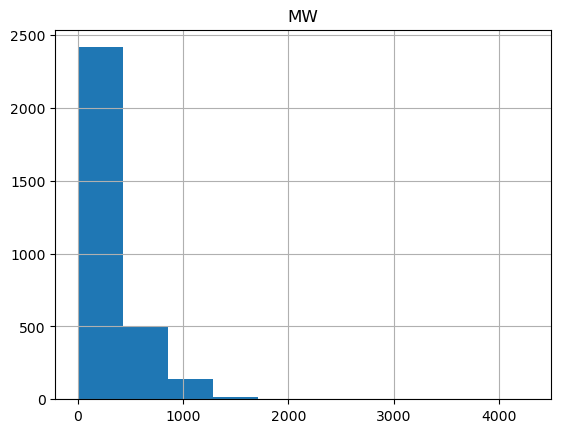

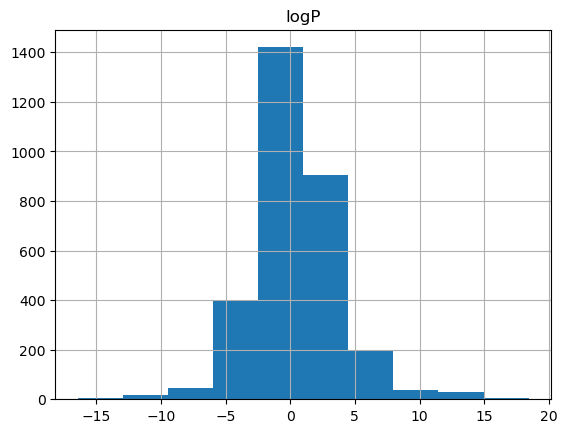

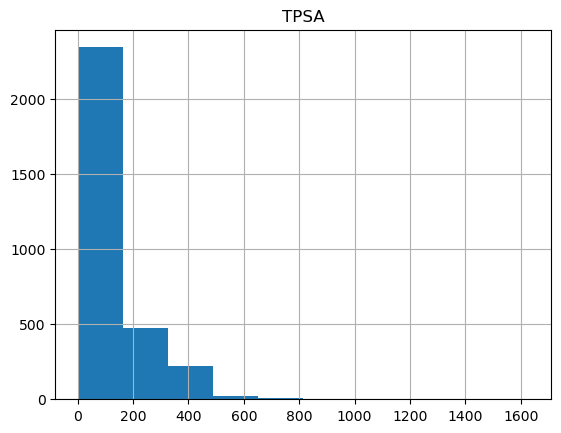

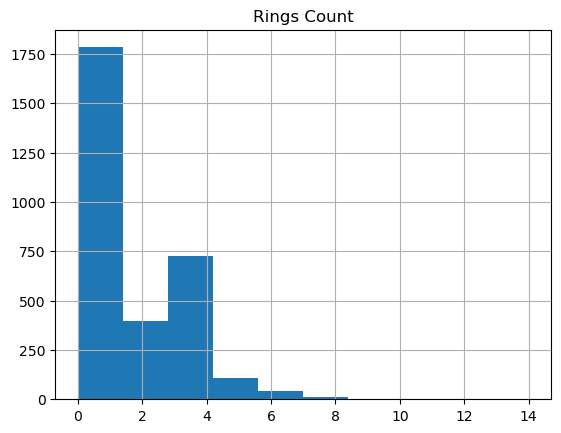

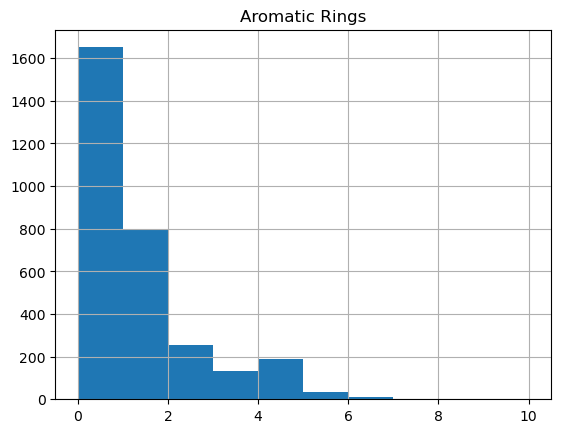

...

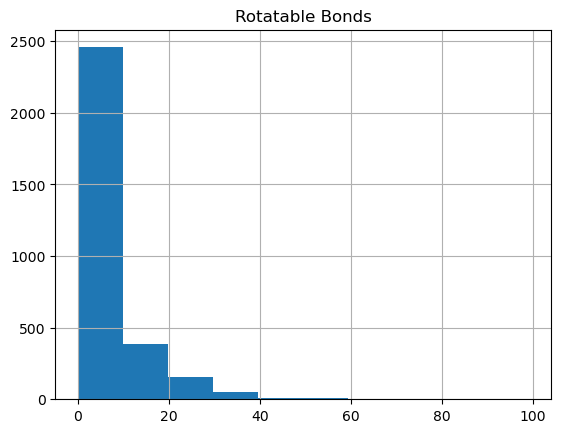

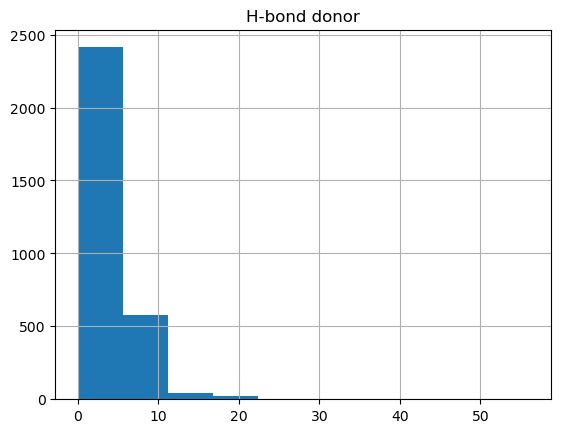

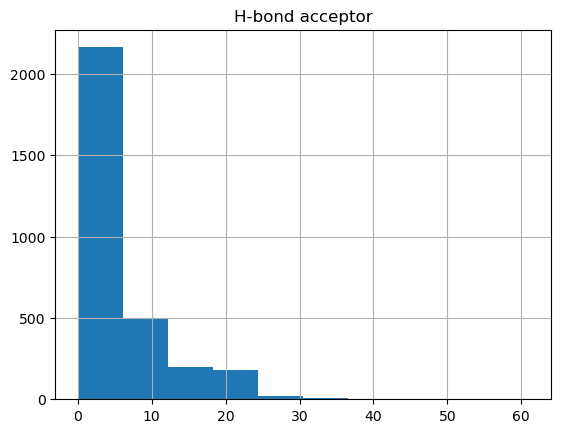

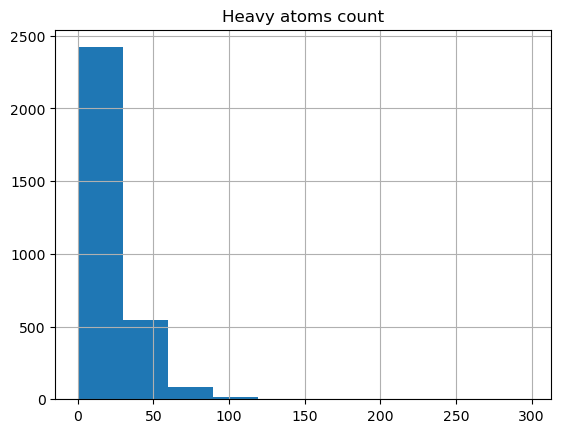

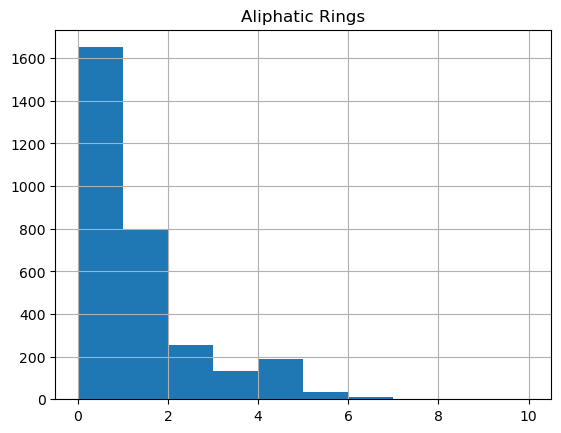

In [17]:
hist1=df.hist(column='MW')
hist2=df.hist(column='logP')
hist3=df.hist(column='TPSA')
hist4=df.hist(column='Rings Count')
hist5=df.hist(column='Aromatic Rings')
hist6=df.hist(column='CSP3')
hist7=df.hist(column='BalabanJ')
hist8=df.hist(column="Rotatable Bonds")
hist9=df.hist(column='H-bond donor')
hist10=df.hist(column='H-bond acceptor')
hist11=df.hist(column="Heavy atoms count")
hist12=df.hist(column="Aliphatic Rings")



Generem un fitxer csv per introduir al programa Chemprop. El fitxer ha de tenir la columna: ReactionSmiles Sabio ID i la suma de fingerprints dels seus substrats i productes. L'objectiu del següent script consisteix en ajuntar el csv que conté els SMILES de les reaccions amb el csv que conté els finguerprints de cada substrat i producte que formen la reacció.

In [26]:
reaccions='data/ReactionSmiles.csv'
features="data/fingerprint.csv"
chempropinput="data/output_file.csv"

dfR = pd.read_csv(reaccions, sep=',')
dfF = pd.read_csv(features, sep=',')


R1="data/tempR1"
R2="data/tempR2"
R3="data/tempR3"

P1="data/tempP1"
P2="data/tempP2"
P3="data/tempP3"

COLUMN_NAMES=["MW",'logP',"TPSA", "Rings Count", "Aromatic Rings", "Heavy atoms cout", "Alifatic Rings", "CSP3", "BalabanJ", "RotatableBonds", "H-bond donor", "H-bond acceptor"]
dfR1= pd.DataFrame(columns=COLUMN_NAMES)
dfR2= pd.DataFrame(columns=COLUMN_NAMES)
dfR3= pd.DataFrame(columns=COLUMN_NAMES)

dfP1= pd.DataFrame(columns=COLUMN_NAMES)
dfP2= pd.DataFrame(columns=COLUMN_NAMES)
dfP3= pd.DataFrame(columns=COLUMN_NAMES)

molecule_descriptors = dfF.set_index('Smiles').to_dict('index')


files=len(dfR.index)

for i in range(files):
    reaction_smiles = dfR.at[i,'Reaction']
    reactants, products = reaction_smiles.split('>>')
    reactant_smiles = reactants.split('.')
    product_smiles = products.split('.')
    r1=reactant_smiles[0]
    dfR1.loc[i]=list(pd.Series(molecule_descriptors[r1]))
    print(dfR1.head())
        
    


           MW    logP    TPSA  Rings Count  Aromatic Rings  Heavy atoms cout  \
0  260.029719 -3.1044  156.91          1.0             1.0              16.0   

   Alifatic Rings  CSP3  BalabanJ  RotatableBonds  H-bond donor  \
0             1.0   1.0  2.572326             3.0           6.0   

   H-bond acceptor  
0              7.0  
           MW    logP    TPSA  Rings Count  Aromatic Rings  Heavy atoms cout  \
0  260.029719 -3.1044  156.91          1.0             1.0              16.0   
1  506.995745 -1.6290  279.13          3.0             1.0              31.0   

   Alifatic Rings  CSP3  BalabanJ  RotatableBonds  H-bond donor  \
0             1.0   1.0  2.572326             3.0           6.0   
1             1.0   0.5  1.689409             8.0           7.0   

   H-bond acceptor  
0              7.0  
1             14.0  
           MW    logP    TPSA  Rings Count  Aromatic Rings  Heavy atoms cout  \
0  260.029719 -3.1044  156.91          1.0             1.0              16.0

KeyError: '[CH-]1C=CC=C1'

In [ ]:
import pandas as pd 

input2 = 'data/fingerprint.csv'
input1 = 'data/ReactionSmiles.csv'
output= 'data/output_file.csv'

df2 = pd.read_csv(input2, sep=',')
df1 = pd.read_csv(input1, sep=',')
print(df1.columns)
print(df2.columns)

#generem un diccionari que assigni les cadenes SMILES als valors dels descriptors
molecule_descriptors = df2.set_index('Smiles').to_dict('index')
print(molecule_descriptors)
# Funció per afegir descriptors a les reaccions.
def add_descriptors(row):
    reaction_smiles = row['Reaction']
    reactants, products = reaction_smiles.split('>>')
    reactant_smiles = reactants.split('.')
    product_smiles = products.split('.')
    llistadescriptors=['MW','logP',"TPSA", "Rings Count", "Aromatic Rings", "Heavy atoms cout", "Alifatic Rings", "CSP3", "BalabanJ", "RotatableBonds", "H-bond donor", "H-bond acceptor"]
       
    reactrow=pd.Series([0]*12,index=llistadescriptors)
    productrow=pd.Series([0]*12,index=llistadescriptors)
    
    
    # Recorre cada reactiu i producte i s'afegeixen els descriptors si aquests es troben al diccionari de descriptors de molècules
    for reactant in reactant_smiles:
        try:
            print("reactant:,",reactant)
            print(molecule_descriptors[reactant])
            ser2=pd.Series(molecule_descriptors[reactant]).drop(labels=['Unnamed: 0']) #eliminem la columna Unnamed i fem la sumna  dels valors de cada variable dels reactius.
            
            print('pd.Series\n',ser2)
            reactrow=reactrow.add(ser2)
        except KeyError:
            print(f"No descriptors found for reactant: {reactant}")

    #print(reactrow)
    for product in product_smiles:
        try:
            print("product:",product)
            print(molecule_descriptors[product])
            ser2=pd.Series(molecule_descriptors[product]).drop(labels=['Unnamed: 0']) #eliminem la columna Unnamed i fem la suma dels valors de cada variable dels productes.
            print('pd.Series\n',ser2)
            productrow=productrow.add(ser2)
        except KeyError:
            print(f"No descriptors found for product: {product}")
    
    row = pd.concat([row, reactrow, productrow], ignore_index=True)
    print(row)
    return row


# Apliquem la funció add_descriptors a cada fila del dataframe de reaccions.
reactions_df = df1.apply(add_descriptors, axis=1)


# escrivim el dataframe en un csv
reactions_df.to_csv('data/reactions_with_descriptors.csv', index=False)

Index(['SabioReactionID', 'Reaction'], dtype='object')
Index(['MW', 'logP', 'TPSA', 'Rings Count', 'Aromatic Rings',
       'Heavy atoms count', 'Aliphatic Rings', 'CSP3', 'BalabanJ',
       'Rotatable Bonds', 'H-bond donor', 'H-bond acceptor', 'Smiles'],
      dtype='object')
{'C([C@@H]1[C@H]([C@@H]([C@H]([C@H](O1)O)O)O)O)OP(=O)(O)O': {'MW': 260.02971862600003, 'logP': -3.104399999999999, 'TPSA': 156.91, 'Rings Count': 1, 'Aromatic Rings': 1, 'Heavy atoms count': 16, 'Aliphatic Rings': 1, 'CSP3': 1.0, 'BalabanJ': 2.572326379287313, 'Rotatable Bonds': 3, 'H-bond donor': 6, 'H-bond acceptor': 7}, 'C([C@@H]1[C@H]([C@@H]([C@](O1)(CO)O)O)O)OP(=O)(O)O': {'MW': 260.02971862600003, 'logP': -3.1028, 'TPSA': 156.91, 'Rings Count': 1, 'Aromatic Rings': 1, 'Heavy atoms count': 16, 'Aliphatic Rings': 1, 'CSP3': 1.0, 'BalabanJ': 2.613201181998435, 'Rotatable Bonds': 4, 'H-bond donor': 6, 'H-bond acceptor': 7}, 'Nc3ncnc1c3(ncn1C2OC(COP(O)(=O)OP(O)(=O)OP(O)(O)=O)C(O)C2(O))': {'MW': 506.9957454619998,

L'objectiu del següent sctipt consisteix en generar un fitxer amb totes les reaccions químiques, amb els seus descriptors i l'ECNumber corresponent a cada reacció química. Per a fer-ho partim del file reactions_with_descriptors.csv on tenim les reaccions i els descriptors i el fitxer ECNumber.csv on tenim guardats els ECNumbers de cada reacció.

In [ ]:

input = 'data/reactions_with_descriptors.csv'
input2='data/ECNumber.csv'
df = pd.read_csv(input, sep=',')
df2 = pd.read_csv(input2, sep="\t")


# Canviem el nom de la primera columna
df = df.rename(columns={df.columns[0]: 'SabioReactionID'})
print(df)

#unim els dos dataframes tenint en compte la columna SabioReactionID
merged_df = pd.merge(df, df2, on="SabioReactionID")
merged_df=merged_df.drop(merged_df[merged_df['ECNumber'] == "-"].index) #Eliminem aquelles reaccions que no disposin d'ECNumber
merged_df.to_csv("data/R_w_D_T.csv", index=False)


      SabioReactionID      1  \
0                   1      1   
1                   2      2   
2                   3      3   
3                   4      4   
4                   5      5   
...               ...    ...   
4755            16493  16493   
4756            16494  16494   
4757            16497  16497   
4758            16502  16502   
4759            16506  16506   

                                                      2   3   4    5  \
0     C([C@@H]1[C@H]([C@@H]([C@H]([C@H](O1)O)O)O)O)O... NaN NaN  1.0   
1     Nc3ncnc1c3(ncn1C2OC(COP(O)(=O)OP(O)(=O)OP(O)(O... NaN NaN  2.0   
2     OC1C(COP(O)(O)=O)OC(O)(COP(O)(O)=O)C1(O)>>[H]C... NaN NaN  1.0   
3           [H]C(O)(C=O)COP(O)(O)=O>>OCC(=O)COP(O)(O)=O NaN NaN  0.0   
4     [H]C(O)(C=O)COP(O)(O)=O.OP(O)(O)=O.c1cc(c[n+](... NaN NaN  2.0   
...                                                 ...  ..  ..  ...   
4755  [H]O[H].NCC(CCC(N)C(O)=O)OP(O)(O)=O>>OP(O)(O)=... NaN NaN  0.0   
4756  Nc3ncnc1c3(ncn1C2OC(COP(O)(=O)OP(

Chemprop realitza prediccions de classificació però només és capaç de classificar en dos grups. Davant el nostre problema, volem classificar les reaccions segons el seu catalizador, els enzims es classifiquen en 8 grans grups, farem el següent: Generarem 8 csv diferents tenint en compte el tipus d'enzim que es vol classificar en cada model:

1- Oxidoreductases: Totes les reaccions catalitzades per oxidoreductasses contindran un 1 a la columna ECNumber sino un 0
2- Transferases: Totes les reaccions catalitzades per transferases contindran un 1 a la columna ECNumber sino un 0
3- Hidrolases: Totes les reaccions catalitzades per hidrolases contindran un 1 a la columna ECNumber sino un 0
4- Liases: Totes les reaccions catalitzades per liases contindran un 1 a la columna ECNumber sino un 0
5- Isomerases: Totes les reaccions catalitzades per isomerases contindran un 1 a la columna ECNumber sino un 0
6- Lligases: Totes les reaccions catalitzades per lligases contindran un 1 a la columna ECNumber sino un 0
7- Translocases: Totes les reaccions catalitzades per translocases contindran un 1 a la columna ECNumber sino un 0

D'aquesta manera podrem generar 7 models diferents per tal de predir quin és el millor enzim per a la reacció d'interès.

In [ ]:

input = 'data/R_w_D_T.csv'
df = pd.read_csv(input, sep=',')

df['ECNumber'] = df['ECNumber'].astype(str)
# Generar los DataFrames para cada valor inicial
for i in range(1, 8):
    # Copiar el DataFrame original
    df_new = df.copy()
    
    # Aplicar la transformación en la columna 'ECNumber'
    df_new['ECNumber'] = df_new['ECNumber'].apply(lambda x: 1 if x.startswith(str(i)) else 0)
    
    # Imprimir el DataFrame resultante
    print(f"DataFrame para valores que empiezan por {i}:")
    print(df_new)
    print("\n")

    filename = f'dataframe_{i}.csv'
    df_new.to_csv(filename, index=False)


DataFrame para valores que empiezan por 1:
      SabioReactionID      1  \
0                   1      1   
1                   2      2   
2                   3      3   
3                   4      4   
4                   5      5   
...               ...    ...   
4968            16493  16493   
4969            16494  16494   
4970            16497  16497   
4971            16502  16502   
4972            16506  16506   

                                                      2   3   4    5  \
0     C([C@@H]1[C@H]([C@@H]([C@H]([C@H](O1)O)O)O)O)O... NaN NaN  1.0   
1     Nc3ncnc1c3(ncn1C2OC(COP(O)(=O)OP(O)(=O)OP(O)(O... NaN NaN  2.0   
2     OC1C(COP(O)(O)=O)OC(O)(COP(O)(O)=O)C1(O)>>[H]C... NaN NaN  1.0   
3           [H]C(O)(C=O)COP(O)(O)=O>>OCC(=O)COP(O)(O)=O NaN NaN  0.0   
4     [H]C(O)(C=O)COP(O)(O)=O.OP(O)(O)=O.c1cc(c[n+](... NaN NaN  2.0   
...                                                 ...  ..  ..  ...   
4968  [H]O[H].NCC(CCC(N)C(O)=O)OP(O)(O)=O>>OP(O)(O)=... NaN NaN  0.0

In [ ]:
input = 'data/dataframe_1.csv'
df = pd.read_csv(input, sep=',')
df = df.drop(df.columns[:2], axis=1)
df.to_csv("data/final.csv", index=False)

FUNFUNCIONS CHEMPROP

CHEMPROP_RES=$HOME/scratch  #aqui li dones una variable amb un path
mkdir $CHEMPROP_RES #crees
wget http://www.bioinf.jku.at/research/lsc/index.html -O $HOME/data.tar.gz #home es una variable de la shell
tar zwf data.tar.gz #descomprimir i creara la carpeta data

# Train
python train.py  --data_path $CHEMPROP_RES/data/tox21.csv --dataset_type classification --save_dir $CHEMPROP_RES/tox21_checkpoint

# Predict
chemprop_predict --test_path $CHEMPROP_RES/data/tox21.csv --checkpoint_dir  $CHEMPROP_RES/tox21_checkpoint --preds_path $CHEMPROP_RES/tox21_preds.csv

# Interpret
chemprop_interpret --data_path $CHEMPROP_RES/data/tox21.csv --checkpoint_dir $CHEMPROP_RES/tox21_checkpoint/fold_0

In [ ]:


CHEMPROP_RES=$HOME/scratch  #aqui li dones una variable amb un path
mkdir $CHEMPROP_RES #crees

# Train
chemprop_train --data_path /Users/annacano/Documents/Doc/TFM/github/TFM_scripts/data/df1.csv  --dataset_type classification --save_dir /Users/annacano/Documents/Doc/TFM/github/TFM_scripts/df1_checkpoint --reaction --reaction_mode reac_prod --explicit_h --target_columns ECNumber

# Predict
chemprop_predict --test_path $CHEMPROP_RES/data/tox21.csv --checkpoint_dir  $CHEMPROP_RES/tox21_checkpoint --preds_path $CHEMPROP_RES/tox21_preds.csv

# Interpret
chemprop_interpret --data_path $CHEMPROP_RES/data/tox21.csv --checkpoint_dir $CHEMPROP_RES/tox21_checkpoint/fold_0

SyntaxError: invalid syntax (299721344.py, line 1)